<a href="https://colab.research.google.com/github/dkimds/goormthon/blob/main/Practice/Appendix/10_1_Logging_%26_tracking_multiple_experiments_Tensorboard_%26_EfficientNet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<br><br>

<p style="color:red; font-size:1.3em;"> * 본 실습에는 <b>0.13 이상 버전의 torchvision</b> 이 필요합니다.</p><br>
<p style="font-size:1.3em;">* Colab 에서 본 실습 파일을 업로드하고 <span style="color:red;"> <b>GPU 로 런타임을 변경</b></span> 후 실습을 진행해주세요!
    
<br>

<br>
<br>

# 0. Import libraries

In [5]:
from IPython.display import clear_output # Cell 내의 출력을 자동으로 지워주는 함수

!pip install torchvision
!pip install torchinfo
!pip install torchmetrics

clear_output() # clear the output after the installation

In [3]:
import torch
import torchvision

print(torch.__version__)
print(torchvision.__version__) # 0.13 이상 버전의 torchvision 이 필요합니다

import torchinfo
import torchmetrics

print(torchinfo.__version__)    # 1.7.1
print(torchmetrics.__version__) # 0.11.0

2.3.0+cu121
0.18.0+cu121
1.8.0
1.4.0.post0


In [4]:
!nvidia-smi

# Check the status of the nvidia GPU

Tue Jul  9 05:56:07 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   60C    P8              12W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [6]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import torch
from torch import nn

from torch.utils.data import DataLoader # class for loading the dataset (Dataset -> Batches)
# from torch.utils.tensorboard import SummaryWriter
from torchmetrics import Accuracy
from torchinfo import summary # summarize the model structure

import torchvision
from torchvision import transforms
from torchvision.datasets import ImageFolder # Load "Image" data from selected "Folder"s

import zipfile
import os
import glob
import random
import pickle
from datetime import datetime

from PIL import Image
from tqdm.auto import tqdm # We will use the tqdm
from timeit import default_timer as timer

In [7]:
def set_seeds(seed=42):

    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)

<br>
<br>

# 1. Prepare the dataset
<br>

### * Original Dataset : **Food-101** @ https://data.vision.ee.ethz.ch/cvl/datasets_extra/food-101/

<br>

- **101** food categories<br>
- **101,000** images<br>
- **750** training images & **250** test images per class<br>
- rescaled to have a **maximum side length of 512 pixels**

<hr>

#### * 구글드라이브에 접속한 후 [ **data_food101** ] 폴더를 만들고 [ **Food101.zip** ] 파일과 [ **sample_pizza.jpg** ] 파일을 업로드해줍니다.

#### * Colab 자동완성 단축키는 [ **Ctrl + Space** ] 입니다.

<hr>

In [12]:
from google.colab import drive, files # files : for downloading files from Colab & Google Drive

drive.mount('/gdrive') # Mount the google-drive

Mounted at /gdrive


In [35]:
data_path = '/gdrive/MyDrive/data_food101/'

for info in os.walk(data_path): # 거닐다
    print(info)

('/gdrive/MyDrive/data_food101/', ['data'], ['Food101.zip', 'sample_pizza.jpg', 'EfficientNet_v1.pth', 'Food101_20percent.zip'])
('/gdrive/MyDrive/data_food101/data', ['test', 'train'], [])
('/gdrive/MyDrive/data_food101/data/test', ['pizza', 'steak', 'sushi'], [])
('/gdrive/MyDrive/data_food101/data/test/pizza', [], ['540882.jpg', '714866.jpg', '194643.jpg', '2236338.jpg', '3092704.jpg', '309892.jpg', '1925494.jpg', '2124579.jpg', '2019408.jpg', '344397.jpg', '2508636.jpg', '195160.jpg', '416067.jpg', '2218680.jpg', '1152100.jpg', '398345.jpg', '2871261.jpg', '971934.jpg', '930553.jpg', '2111981.jpg', '3475871.jpg', '648055.jpg', '1687143.jpg', '1503858.jpg', '2003290.jpg'])
('/gdrive/MyDrive/data_food101/data/test/steak', [], ['296375.jpg', '354513.jpg', '690177.jpg', '1882831.jpg', '894825.jpg', '3424937.jpg', '2117351.jpg', '2144308.jpg', '502076.jpg', '100274.jpg', '1285886.jpg', '1302563.jpg', '966174.jpg', '3873283.jpg', '27415.jpg', '1868005.jpg', '1627703.jpg', '673127.jpg', '

In [ ]:
with zipfile.ZipFile(data_path + "Food101.zip", "r") as zip_f:

    print("Unzipping the dataset.")

    zip_f.?(data_path + "data") # "extract" "all" files

Unzipping the dataset.


In [ ]:
for dir_path, dir_names, file_names in os.walk(data_path + "data"):

    if len(dir_names) == 3:
        print('--------------------------------')

    print("There are {} directories and {} images in '{}'.".format(len(dir_names), len(file_names), dir_path))

There are 2 directories and 0 images in '/gdrive/MyDrive/data_food101/data'.
--------------------------------
There are 3 directories and 0 images in '/gdrive/MyDrive/data_food101/data/test'.
There are 0 directories and 25 images in '/gdrive/MyDrive/data_food101/data/test/pizza'.
There are 0 directories and 19 images in '/gdrive/MyDrive/data_food101/data/test/steak'.
There are 0 directories and 31 images in '/gdrive/MyDrive/data_food101/data/test/sushi'.
--------------------------------
There are 3 directories and 0 images in '/gdrive/MyDrive/data_food101/data/train'.
There are 0 directories and 78 images in '/gdrive/MyDrive/data_food101/data/train/pizza'.
There are 0 directories and 75 images in '/gdrive/MyDrive/data_food101/data/train/steak'.
There are 0 directories and 72 images in '/gdrive/MyDrive/data_food101/data/train/sushi'.


In [8]:
TRAIN_DIR = "/gdrive/MyDrive/data_food101/data/train"
TEST_DIR  = "/gdrive/MyDrive/data_food101/data/test"

<br>
<br>

# 2. Prepare the **DataLoader**

In [9]:
# Pre-trained weights (EfficientNet_B0 on ImageNet)
weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT # .DEFAULT = best available weights on ImageNet

# The transforms that were used to train the "EfficientNet_B0_Weights" on "ImageNet"
transform_efficientNet = weights.transforms() # "transforms" that were used to train "weights"

In [13]:
# Load "Image" data from selected "Folder"s

train_imgfolder = ImageFolder(root=TRAIN_DIR,
                              transform=transform_efficientNet) # The transforms that were used to train the "EfficientNet_B0_Weights" on "ImageNet"

test_imgfolder  = ImageFolder(root=TEST_DIR,
                              transform=transform_efficientNet) # Augmentation이 적용되어있지 않으므로 test set에도 동일하게 활용 가능

class_names = train_imgfolder.classes

In [15]:
# class for loading the dataset (Dataset -> Batches)

set_seeds(42)

train_dataloader = DataLoader(dataset=train_imgfolder,
                              batch_size=32,
                              num_workers=os.cpu_count(), # number of subprocesses to use for data loading
                              shuffle=True,
                              pin_memory=True)

test_dataloader  = DataLoader(dataset=test_imgfolder,
                              batch_size=32,
                              num_workers=os.cpu_count(),
                              shuffle=False,
                              pin_memory=True)

<class 'torch.Tensor'>
torch.Size([3, 224, 224])
torch.float32


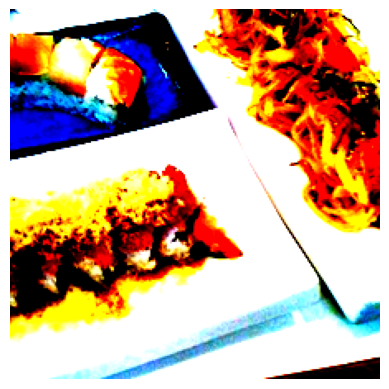

In [16]:
batch_x, batch_y = next(iter(train_dataloader))

image_sample = batch_x[0]

print(type(image_sample))
print(image_sample.shape) # after the data-augmentation
print(image_sample.dtype)

plt.imshow(image_sample.permute(1, 2, 0)) # permutation
plt.axis("off")
plt.show()

<br>
<br>

# 3. Build the model with **pre-trained models**

#### * **EfficientNet** : Rethinking Model Scaling for Convolutional Neural Networks @ https://arxiv.org/abs/1905.11946

In [17]:
device = "cuda" if torch.cuda.is_available() else "cpu" # "cuda"가 사용 가능하다면 (if it "is available")

device

'cuda'

In [19]:
weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT

model = torchvision.models.efficientnet_b0(weights=weights).to(device) # torchvision v0.13+
# model = torchvision.models.efficientnet_b0(pretrained=True).to(device) # old version ("pretrained=True")


# Sequential (features)
for param in model.features.parameters():
    param.requires_grad = False # "requires" "grad"ient-descent

# Sequential (classifier)
set_seeds(42)
model.classifier = torch.nn.Sequential(
    nn.Dropout(0.2, inplace=True), # Apply the drop-out
    nn.Linear(in_features=1280, # == 1280 * 1 * 1
              out_features=len(class_names))
)


summary(model=model,
        input_size=(32, 3, 224, 224),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        # depth=10, # check what happens with this change
        row_settings=["var_names"]
)

Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 153MB/s]


Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 3]              --                   Partial
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1280, 7, 7]     --                   False
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   False
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   (864)                False
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   (64)                 False
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 

<br>
<br>

# 4. Train the model

### 1) Make train & test step as separate functions

In [20]:
def train_step(model, dataloader, loss_fn, optimizer, metric, device):

    # 모델을 training mode로 설정 (default state)
    model.train()

    # train-loss & train-accuracy for one epoch
    train_loss = 0
    train_acc  = 0

    for batch_idx, (X, y) in enumerate(dataloader): # X & y == a single batch

        X = X.to(device)
        y = y.to(device)

        # 1. (x 데이터를 모델에 넣고) 순방향 계산 진행 (forward pass)
        logits = model(X)

        # 2. (Batch) Training cost 계산 (Cost function 계산)
        loss = loss_fn(logits, y) # cost of batch <- nn.CrossEntropyLoss() : built-in Softmax
        train_loss += loss.item()

        # 3. Optimizer 내부의 이전 gradient 값 초기화 (Make "grad" to "zero")
        optimizer.zero_grad()

        # 4. Back-propagation ("Backward" propagation)
        loss.backward()

        # 5. Gradient descent 진행 (Take a "step" to update parameters)
        optimizer.step()

        # 6. (Batch) Training accuracy 계산
        predicted_classes = logits.softmax(dim=1).argmax(dim=1)
        train_acc += metric(predicted_classes, y).item() # calculate the batch accuracy & add to the epoch accuracy


    # Batch 순회 종료 후
    train_loss = train_loss / len(dataloader) # cost of batches / num of batches (calculate average)
    train_acc  = train_acc  / len(dataloader) # acc  of batches / num of batches (calculate average)

    return train_loss, train_acc

In [21]:
def test_step(model, dataloader, loss_fn, metric, device):

    # 모델을 evaluation mode로 설정
    model.eval()

    # test-loss & test-accuracy for one epoch
    test_loss = 0
    test_acc  = 0

    with torch.inference_mode(): # Set "inference mode"

        for batch_idx, (X, y) in enumerate(dataloader): # X & y == a single batch

            X = X.to(device)
            y = y.to(device)

            # 1. (x 데이터를 모델에 넣고) 순방향 계산 진행 (forward pass)
            logits = model(X)

            # 2. (Batch) Test cost 계산 (Cost function 계산)
            loss = loss_fn(logits, y) # cost of batch <- nn.CrossEntropyLoss() : built-in Softmax
            test_loss += loss.item()

            # 3. (Batch) Test accuracy 계산
            predicted_classes = logits.softmax(dim=1).argmax(dim=1)
            test_acc += metric(predicted_classes, y).item() # calculate the batch accuracy & add to the epoch accuracy


    # Batch 순회 종료 후
    test_loss = test_loss / len(dataloader) # cost of batches / num of batches (calculate average)
    test_acc  = test_acc  / len(dataloader) # acc  of batches / num of batches (calculate average)

    return test_loss, test_acc

<br>

### 2) Combine train & test step into a simplified "train" function

<hr>

#### * torch.utils.**tensorboard.SummaryWriter**() @ https://bit.ly/3h2BEXZ

#### * (Tensorflow Official) 텐서보드 시작하기 @ https://bit.ly/3iBUINf

#### * (Tensorflow Official) 노트북에서 텐서보드 사용 @ https://bit.ly/3EZFedr

#### * VS Code Guide on TensorBoard and PyTorch @ https://bit.ly/3upWYd6

#### * (TensorBoard.dev) Upload experiments & share them publicly @ https://bit.ly/3HbonqS

<hr>

In [22]:
from torch.utils.tensorboard import SummaryWriter

In [25]:
writer = SummaryWriter() # Create a "SummaryWriter"

# writer.add_scalars(main_tag, tag_scalar_dict) # https://bit.ly/3unxbCf (add_scalar / add_text / add_figure / add_graph / add_hparams / etc.)
# main_tag (string)  : the name for the scalars being tracked (ex. "Accuracy")
# tag_scalar_dict (dict) : a dict of the values being tracked (ex. {"train_loss": 0.3454})

for i in range(100):

    writer.add_scalars(main_tag='run_14h',
                       tag_scalar_dict={'xsinx' : i * np.sin(i / 5),
                                        'xcosx': i * np.cos(i / 5),
                                        'tanx' : np.tan(i / 5)},
                       global_step=i) # Global step value to record

writer.close() # Close the tensorboard.SummaryWriter


# Load the TensorBoard
%load_ext tensorboard

# Run TensorBoard session with the "runs/" directory (== writer 가 결과값을 저장하는 directory)
%tensorboard --logdir runs

# check the Colab's local directory ("runs/CURRENT_DATETIME_HOSTNAME")

<IPython.core.display.Javascript object>

In [26]:
# Delete the previous results of the Tensorboard

!rm -rf runs

In [27]:
def train(model,
          train_dataloader,
          test_dataloader,
          optimizer,
          loss_fn,
          metric,
          device,
          epochs):


    results = {"train_loss": [],
               "train_acc" : [],
               "test_loss" : [],
               "test_acc"  : []}

    writer = SummaryWriter() # Create a "SummaryWriter"


    for epoch in tqdm(range(epochs)): # from tqdm.auto import tqdm

        train_loss, train_acc = train_step(model=model,
                                           dataloader=train_dataloader,
                                           loss_fn=loss_fn,
                                           optimizer=optimizer,
                                           metric=metric,
                                           device=device)

        test_loss, test_acc   = test_step(model=model,
                                          dataloader=test_dataloader,
                                          loss_fn=loss_fn,
                                          metric=metric,
                                          device=device)


        results["train_loss"].append(train_loss)
        results["train_acc"].append(train_acc)
        results["test_loss"].append(test_loss)
        results["test_acc"].append(test_acc)


        print('Epoch : {} | Train_loss : {} | Train_acc : {} | Test_loss : {} | Test_acc : {}'.format(epoch+1,
                                                                                                      train_loss,
                                                                                                      train_acc,
                                                                                                      test_loss,
                                                                                                      test_acc))

        # for tensorboard.SummaryWriter

        writer.add_scalars(main_tag="Loss",
                           tag_scalar_dict={"train_loss": train_loss,
                                            "test_loss" : test_loss},
                           global_step=epoch) # Global step value to record -> set "epoch"

        writer.add_scalars(main_tag="Accuracy",
                           tag_scalar_dict={"train_acc": train_acc,
                                            "test_acc" : test_acc},
                           global_step=epoch) # Global step value to record -> set "epoch"

        writer.add_graph(model=model,
                         input_to_model=torch.randn(32, 3, 224, 224).to(device)) # example input

    writer.close() # Close the tensorboard.SummaryWriter

    return results

<br>

### 3) Train the model & Check the result

In [28]:
loss_fn = nn.CrossEntropyLoss() # Softmax + CrossEntropy (built-in Softmax)

optimizer = torch.optim.Adam(params=model.parameters(), # "parameters" to optimize (apply gradient descent)
                             lr=0.001)                  # "l"earning "r"ate

metric_accuracy = Accuracy(task="multiclass", num_classes=3).to(device) # from torchmetrics import Accuracy

In [29]:
START_TIME = timer() # from timeit import default_timer as timer

NUM_EPOCHS = 30

model_results = train(model=model,
                      train_dataloader=train_dataloader,
                      test_dataloader=test_dataloader,
                      optimizer=optimizer,
                      loss_fn=loss_fn,
                      metric=metric_accuracy,
                      device=device,
                      epochs=30)

END_TIME = timer()

print('Training time : {} seconds'.format(round(END_TIME-START_TIME, 2)))

  0%|          | 0/30 [00:00<?, ?it/s]

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Epoch : 1 | Train_loss : 1.046397976577282 | Train_acc : 0.38671875 | Test_loss : 0.837496260801951 | Test_acc : 0.7339015205701193
Epoch : 2 | Train_loss : 0.8729479610919952 | Train_acc : 0.64453125 | Test_loss : 0.6864608923594157 | Test_acc : 0.9479166666666666
Epoch : 3 | Train_loss : 0.7297663986682892 | Train_acc : 0.86328125 | Test_loss : 0.694465438524882 | Test_acc : 0.7547348539034525
Epoch : 4 | Train_loss : 0.7436808571219444 | Train_acc : 0.68359375 | Test_loss : 0.672636071840922 | Test_acc : 0.7746212085088094
Epoch : 5 | Train_loss : 0.5928610488772392 | Train_acc : 0.89453125 | Test_loss : 0.5872058669726054 | Test_acc : 0.8759469787279764
Epoch : 6 | Train_loss : 0.595621544867754 | Train_acc : 0.80078125 | Test_loss : 0.5594867467880249 | Test_acc : 0.8352272709210714
Epoch : 7 | Train_loss : 0.523898296058178 | Train_acc : 0.8984375 | Test_loss : 0.4891134401162465 | Test_acc : 0.8759469787279764
Epoch : 8 | Train_loss : 0.4988963305950165 | Train_acc : 0.91015625 

In [30]:
# Load the TensorBoard
%load_ext tensorboard

# Run TensorBoard session with the "runs/" directory (== writer 가 결과값을 저장하는 directory)
%tensorboard --logdir runs

# check the Colab's local directory ("runs/CURRENT_DATETIME_HOSTNAME")

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 6197), started 0:08:45 ago. (Use '!kill 6197' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# Delete the previous results of the Tensorboard

!rm -rf runs

<br>
<br>

# 5. Prepare the multiple experiments

### 1) Prepare the function for setting the SummaryWriter

<hr>

#### let's set the "**log_dir**" as like

#### -> [ runs/**YYYY-MM-DD**/**name_experiment**/**name_model**/**etc** ] (etc : number of epochs, size of train-data, etc.)

<hr>

In [31]:
from datetime import datetime
import os

In [32]:
def create_writer(name_experiment, name_model, etc):

    timestamp = datetime.now().strftime("%Y-%m-%d") # YYYY-MM-DD (String-formatted time)

    if etc:
        log_dir = os.path.join("runs", timestamp, name_experiment, name_model, etc) # Join the names of multiple directories
    else:
        log_dir = os.path.join("runs", timestamp, name_experiment, name_model)

    print("[INFO] SummaryWriter will save the results to: {}...".format(log_dir))

    return SummaryWriter(log_dir=log_dir) # Create & return a "SummaryWriter"

<br>

### 2) Update the function "**train**" to use the function "create_writer"

In [33]:
def train(model,
          train_dataloader,
          test_dataloader,
          optimizer,
          loss_fn,
          metric,
          device,
          epochs,
          writer): # New parameter


    results = {"train_loss": [],
               "train_acc" : [],
               "test_loss" : [],
               "test_acc"  : []}

    # writer = SummaryWriter() # Create a "SummaryWriter"


    for epoch in tqdm(range(epochs)): # from tqdm.auto import tqdm

        train_loss, train_acc = train_step(model=model,
                                           dataloader=train_dataloader,
                                           loss_fn=loss_fn,
                                           optimizer=optimizer,
                                           metric=metric,
                                           device=device)

        test_loss, test_acc   = test_step(model=model,
                                          dataloader=test_dataloader,
                                          loss_fn=loss_fn,
                                          metric=metric,
                                          device=device)


        results["train_loss"].append(train_loss)
        results["train_acc"].append(train_acc)
        results["test_loss"].append(test_loss)
        results["test_acc"].append(test_acc)


        print('Epoch : {} | Train_loss : {} | Train_acc : {} | Test_loss : {} | Test_acc : {}'.format(epoch+1,
                                                                                                      train_loss,
                                                                                                      train_acc,
                                                                                                      test_loss,
                                                                                                      test_acc))

        # for tensorboard.SummaryWriter
        if writer :

            writer.add_scalars(main_tag="Loss",
                               tag_scalar_dict={"train_loss": train_loss,
                                                "test_loss" : test_loss},
                               global_step=epoch) # Global step value to record -> set "epoch"

            writer.add_scalars(main_tag="Accuracy",
                               tag_scalar_dict={"train_acc": train_acc,
                                                "test_acc" : test_acc},
                               global_step=epoch) # Global step value to record -> set "epoch"

            writer.close() # Close the tensorboard.SummaryWriter

        else:
            pass

    return results

<br>

### 3) Set up a series of experiments

- \# of **epochs**
- \# number of **layers** (hidden units, filters)
- the amount of **training-data** (test-data should remain same as possible)
- the **learning rate**
- the kinds of **data-augmentation**
- the **model architecture**

<br>

### 3-1) Prepare the bigger dataset (+ DataLoader)

<hr>

#### * 구글드라이브에 접속한 후 [ **data_food101** ] 폴더 안에 [ **Food101_20percent.zip** ] 파일을 추가로 업로드해줍니다.

<hr>

In [36]:
with zipfile.ZipFile(data_path + "Food101_20percent.zip", "r") as zip_f:

    print("Unzipping the dataset.")

    zip_f.extractall(data_path + "data_20percent") # "extract" "all" files


for dir_path, dir_names, file_names in os.walk(data_path + "data_20percent"): # 거닐다

    if len(dir_names) == 3:
        print('--------------------------------')

    print("There are {} directories and {} images in '{}'.".format(len(dir_names), len(file_names), dir_path))

    # training data : 75 per class (10%) -> 150 per class (20%)

Unzipping the dataset.
There are 2 directories and 0 images in '/gdrive/MyDrive/data_food101/data_20percent'.
--------------------------------
There are 3 directories and 0 images in '/gdrive/MyDrive/data_food101/data_20percent/test'.
There are 0 directories and 46 images in '/gdrive/MyDrive/data_food101/data_20percent/test/pizza'.
There are 0 directories and 58 images in '/gdrive/MyDrive/data_food101/data_20percent/test/steak'.
There are 0 directories and 46 images in '/gdrive/MyDrive/data_food101/data_20percent/test/sushi'.
--------------------------------
There are 3 directories and 0 images in '/gdrive/MyDrive/data_food101/data_20percent/train'.
There are 0 directories and 154 images in '/gdrive/MyDrive/data_food101/data_20percent/train/pizza'.
There are 0 directories and 146 images in '/gdrive/MyDrive/data_food101/data_20percent/train/steak'.
There are 0 directories and 150 images in '/gdrive/MyDrive/data_food101/data_20percent/train/sushi'.


In [37]:
# for dir_path, dir_names, file_names in os.walk(data_path + "data"):

#     if len(dir_names) == 3:
#         print('--------------------------------')

#     print("There are {} directories and {} images in '{}'.".format(len(dir_names), len(file_names), dir_path))

In [38]:
TRAIN_DIR_10_PERCENT = "/gdrive/MyDrive/data_food101/data/train"
TRAIN_DIR_20_PERCENT = "/gdrive/MyDrive/data_food101/data_20percent/train"

TEST_DIR  = "/gdrive/MyDrive/data_food101/data/test" # test-data should remain same as possible

In [39]:
# Pre-trained weights (EfficientNet_B0 on ImageNet)
weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT # .DEFAULT = best available weights on ImageNet

# The transforms that were used to train the "EfficientNet_B0_Weights" on "ImageNet"
transform_efficientNet = weights.transforms() # "transforms" that were used to train "weights"


# Load "Image" data from selected "Folder"s
train_10_imgfolder = ImageFolder(root=TRAIN_DIR_10_PERCENT, transform=transform_efficientNet)
train_20_imgfolder = ImageFolder(root=TRAIN_DIR_20_PERCENT, transform=transform_efficientNet)
test_imgfolder     = ImageFolder(root=TEST_DIR,             transform=transform_efficientNet)

class_names = train_10_imgfolder.classes


# class for loading the dataset (Dataset -> Batches)
set_seeds(42)

train_10_dataloader = DataLoader(dataset=train_10_imgfolder,
                                 batch_size=32,
                                 num_workers=os.cpu_count(), # number of subprocesses to use for data loading
                                 shuffle=True,
                                 pin_memory=True)

train_20_dataloader = DataLoader(dataset=train_20_imgfolder,
                                 batch_size=32,
                                 num_workers=os.cpu_count(), # number of subprocesses to use for data loading
                                 shuffle=True,
                                 pin_memory=True)

# test-data should remain same as possible
test_dataloader  = DataLoader(dataset=test_imgfolder,
                              batch_size=32,
                              num_workers=os.cpu_count(),
                              shuffle=False,
                              pin_memory=True)

<br>

### 3-2) Prepare the bigger model

<hr>
<br>

#### * torchvision.models.efficientnet_**b0**() @ https://bit.ly/3B96rt9

#### * torchvision.models.efficientnet_**b2**() @ https://bit.ly/3B9CFnP

<br>
<hr>

<br>

* Check the number of "**in_features**" of **classfier layer** (efficientnet_b0 vs efficientnet_b2)


In [40]:
# EfficientNet_B0

weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT
model = torchvision.models.efficientnet_b0(weights=weights).to(device)

# Summarize the model
summary(model=model,
        input_size=(32, 3, 224, 224),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
)

# 1280

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 1000]           --                   True
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1280, 7, 7]     --                   True
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   True
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   864                  True
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   64                   True
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 16, 112

In [41]:
# EfficientNet_B2

weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT
model = torchvision.models.efficientnet_b2(weights=weights).to(device)

summary(model=model,
        input_size=(32, 3, 224, 224),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
)

# 1408

Downloading: "https://download.pytorch.org/models/efficientnet_b2_rwightman-c35c1473.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b2_rwightman-c35c1473.pth
100%|██████████| 35.2M/35.2M [00:00<00:00, 159MB/s]


Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 1000]           --                   True
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1408, 7, 7]     --                   True
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   True
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   864                  True
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   64                   True
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 16, 112

<br>

* Create a function to build models accordingly

In [42]:
# import torchvision
# from torch import nn


def build_model(model_name='EfficientNet_B0'):


    if model_name == 'EfficientNet_B0':

        weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT # .DEFAULT = best available weights on ImageNet
        model   = torchvision.models.efficientnet_b0(weights=weights).to(device)
        IN_FEATURES_CLASSIFIER = 1280

    elif model_name == "EfficientNet_B2":

        weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT # .DEFAULT = best available weights on ImageNet
        model   = torchvision.models.efficientnet_b2(weights=weights).to(device)
        IN_FEATURES_CLASSIFIER = 1408


    # Sequential (features)
    for param in model.features.parameters():
        param.requires_grad = False # "requires" "grad"ient-descent


    # Sequential (classifier)
    set_seeds(42)
    model.classifier = nn.Sequential(
        nn.Dropout(p=0.2), # Apply the drop-out
        nn.Linear(in_features=IN_FEATURES_CLASSIFIER, out_features=3) # "in_features" for the classifier layer
    ).to(device)


    model.name = model_name # Can set the model's name
    print("[INFO] Created new [{}] model".format(model.name))

    return model

<br>

### 3-3) Prepare the function for saving models

In [45]:
def save_model(model,
               target_dir,
               model_name):

    os.makedirs(target_dir, exist_ok=True) # Make directories

    model_save_path = target_dir + '/' + model_name
    print("[INFO] Saving model to: {}".format(model_save_path))

    torch.save(obj=model.state_dict(),
               f=model_save_path)

<br>
<br>

# 6. Run the multiple experiments

<br>

### 1) Set the scope of the experiments

In [46]:
# Scope 1. The size of the training dataset
candidate_loaders = {"data_10_percent": train_10_dataloader,
                     "data_20_percent": train_20_dataloader}

# Scope 2. The size of the model
candidate_models = ["EfficientNet_B0", "EfficientNet_B2"]

# Scope 3. The number of epochs
candidate_epochs = [15, 30]

<br>

### 2) Run multiple experiments at once

In [ ]:
%%time


set_seeds(42)

idx_experiment = 0 # will be used as an identifier of the saved models (.pth)

result_per_model = {} # will collect the best test-accuracy of each model


# Scope 1. The size of the training dataset (10% or 20%)
for name_dataloader, train_dataloader in candidate_loaders.items():

    # Scope 3. The number of epochs (15 or 30)
    for epochs in candidate_epochs:

        # Scope 2. The size of the model (EfficientNet_B0 or EfficientNet_B2)
        for model_name in candidate_models:


            # 1) print the settings of the current experiment
            idx_experiment += 1
            print("[INFO] Experiment  : {}".format(idx_experiment))
            print("[INFO] Model       : {}".format(model_name))
            print("[INFO] DataLoader  : {}".format(name_dataloader))
            print("[INFO] # of epochs : {}".format(epochs))


            # 2) Build the model
            model = build_model(model_name) # "EfficientNet_B0" vs "EfficientNet_B2"


            # 3) Train the model
            loss_fn = nn.CrossEntropyLoss() # Softmax + CrossEntropy (built-in Softmax)
            optimizer = torch.optim.Adam(lr=0.001, params=model.parameters()) # "parameters" to optimize (apply gradient descent)
            metric_accuracy = Accuracy(task="multiclass", num_classes=3).to(device) # from torchmetrics import Accuracy

            writer = create_writer(name_experiment=name_dataloader, # The name of the DataLoader
                                   name_model=model_name,
                                   etc='{}_epochs'.format(epochs))

            model_results = train(model=model,
                                train_dataloader=train_dataloader, # Current DataLoader
                                test_dataloader=test_dataloader,
                                optimizer=optimizer,
                                loss_fn=loss_fn,
                                metric=metric_accuracy,
                                device=device,
                                epochs=epochs,
                                writer=writer) # Writer for the Tensorboard


            # 4) Save the model (params)
            save_filepath = "{}_{}_{}_{}_epochs.pth".format(idx_experiment, model_name, name_dataloader, epochs)

            save_model(model=model,
                       target_dir='/gdrive/MyDrive/data_food101/models',
                       model_name=save_filepath)


            # 5) Collect the best test-accuracy of the current experiment
            result_per_model[save_filepath[:-4]] = max(model_results['test_acc'])

            print("-" * 50 + "\n")


# Save the summary of the experiments (the best test-accuracy of each experiment)
with open('/gdrive/MyDrive/data_food101/' + 'experiments_summary.pkl', 'wb') as f:
    pickle.dump(result_per_model, f)

# Download the saved pickle file of the experiment summary
files.download('/gdrive/MyDrive/data_food101/' + 'experiments_summary.pkl') # from google.colab import files

<br>

### 3) Check the result of the experiment

In [48]:
# Load the TensorBoard
%reload_ext tensorboard

# Run TensorBoard session with the "runs/" directory (== writer 가 결과값을 저장하는 directory)
%tensorboard --logdir runs

# Set "Smoothing"(moving average) as 0 & Filter "runs" with the word "test_"
# Check the Colab's local directory ("runs/")

Reusing TensorBoard on port 6006 (pid 6197), started 0:52:35 ago. (Use '!kill 6197' to kill it.)

<IPython.core.display.Javascript object>

In [49]:
# Upload the results to TensorBoard.dev

!tensorboard dev upload --logdir runs \
                        --name "Experiment result: TorchVision EfficientNet for classify food images (3-classes)" \
                        --description "Experiment on [ the size of the model, the amount of training-data, the number of epochs ]"


# 1) Type "yes"
# 2) Authorize this application
# 3) Stop the execution of this cell after "Total uploaded: ~"

2024-07-09 07:09:00.829244: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-07-09 07:09:00.829300: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-07-09 07:09:00.830618: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-07-09 07:09:01.946196: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
****************************************************************
****************************************************************
****************************************************************

Uploading TensorBoard logs to https://tensorb

In [50]:
# Delete the previous results of the Tensorboard

!rm -rf runs

<br>
<br>

# 7. Load the best model & predict on several images

#### * (**TensorBoard** -> **DataFrame**) TensorBoard 데이터에 DataFrame으로 액세스하기 @ https://bit.ly/3VMnetC

In [ ]:
# from google.colab import files

# files.upload() # Directly upload the file 'experiments_summary.pkl' to the Colab's local directory.

In [51]:
# from google.colab import drive

drive.mount('/gdrive') # Mount the google-drive

with open('/gdrive/MyDrive/data_food101/' + 'experiments_summary.pkl', 'rb') as f:
    experiments_summary = pickle.load(f) # Open a pickle file

experiments_summary

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).


{'1_EfficientNet_B0_data_10_percent_15_epochs': 0.8958333333333334,
 '2_EfficientNet_B2_data_10_percent_15_epochs': 0.9176136453946432,
 '3_EfficientNet_B0_data_10_percent_30_epochs': 0.8958333333333334,
 '4_EfficientNet_B2_data_10_percent_30_epochs': 0.9479166666666666,
 '5_EfficientNet_B0_data_20_percent_15_epochs': 0.9488636453946432,
 '6_EfficientNet_B2_data_20_percent_15_epochs': 0.9583333333333334,
 '7_EfficientNet_B0_data_20_percent_30_epochs': 0.9488636453946432,
 '8_EfficientNet_B2_data_20_percent_30_epochs': 0.9791666666666666}

In [52]:
df_summary = pd.DataFrame(data = experiments_summary.items(),
                          columns=['Experiment', 'Test accuracy'])

df_summary = df_summary.sort_values('Test accuracy', ascending=False)

df_summary

# Model      : EfficientNet_B2
# DataLoader : data_20_percent (20%)
# Epochs     : 30

,Experiment,Test accuracy
7,8_EfficientNet_B2_data_20_percent_30_epochs,0.979167
5,6_EfficientNet_B2_data_20_percent_15_epochs,0.958333
6,7_EfficientNet_B0_data_20_percent_30_epochs,0.948864
4,5_EfficientNet_B0_data_20_percent_15_epochs,0.948864
3,4_EfficientNet_B2_data_10_percent_30_epochs,0.947917
1,2_EfficientNet_B2_data_10_percent_15_epochs,0.917614
2,3_EfficientNet_B0_data_10_percent_30_epochs,0.895833
0,1_EfficientNet_B0_data_10_percent_15_epochs,0.895833


In [ ]:
# # import torchvision
# # from torch import nn


# # Create an EffNetB0 feature extractor
# def build_model(model_name='EfficientNet_B0'):


#     if model_name == 'EfficientNet_B0':

#         weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT # .DEFAULT = best available weights on ImageNet
#         model   = torchvision.models.efficientnet_b0(weights=weights).to(device)
#         IN_FEATURES_CLASSIFIER = 1280

#     elif model_name == "EfficientNet_B2":

#         weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT # .DEFAULT = best available weights on ImageNet
#         model   = torchvision.models.efficientnet_b2(weights=weights).to(device)
#         IN_FEATURES_CLASSIFIER = 1408


#     # Sequential (features)
#     for param in model.features.parameters():
#         param.requires_grad = False # "requires" "grad"ient-descent


#     # Sequential (classifier)
#     set_seeds(42)
#     model.classifier = nn.Sequential(
#         nn.Dropout(p=0.2), # Apply the drop-out
#         nn.Linear(in_features=IN_FEATURES_CLASSIFIER, out_features=3) # "in_features" for the classifier layer
#     ).to(device)


#     model.name = model_name # Can set the model's name
#     print("[INFO] Created new [{}] model".format(model.name))

#     return model

In [53]:
# Initialize the model
best_model = build_model('EfficientNet_B2')

# Load the saved parameters
best_model_path = "/gdrive/MyDrive/data_food101/models/" + "8_EfficientNet_B2_data_20_percent_30_epochs.pth"
best_model.load_state_dict(torch.load(best_model_path)) # load -> load_state_dict

[INFO] Created new [EfficientNet_B2] model


<All keys matched successfully>

In [56]:
def predict_img(model, image_path, class_names, transform, device):

    img = Image.open(image_path) # from PIL import Image

    if transform is not None:
      image_transform = transform
    else:
      image_transform = transforms.Compose([
          transforms.Resize((224, 224)), # ImageNet
          transforms.ToTensor(), # value / 255.0
          transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                std=[0.229, 0.224, 0.225]),
      ])

    img_tensor = image_transform(img).to(device)
    img_tensor = img_tensor.unsqueeze(dim=0) # [Channels, Height, Width] -> [Batch_size, Channels, Height, Width]


    model.to(device)
    model.eval()

    with torch.inference_mode():
        img_logits = model(img_tensor)


    predicted_prob = img_logits.softmax(dim=1).max(dim=1)[0].item()
    predicted_class = img_logits.softmax(dim=1).argmax(dim=1)
    predicted_class_name = class_names[predicted_class]


    plt.figure(figsize=(5, 5), dpi=100)
    plt.imshow(img)

    title = "Pred: {} | Prob: {:.2f}%".format(predicted_class_name, predicted_prob * 100)
    plt.title(title)
    plt.axis(False)
    plt.show()

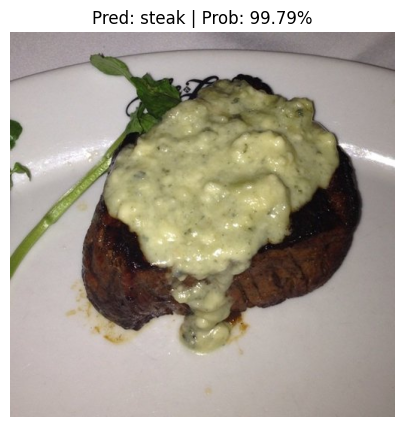

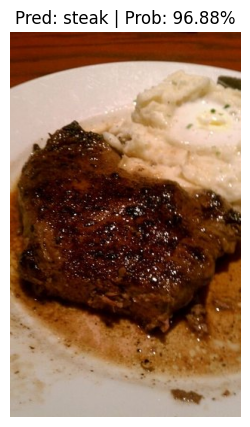

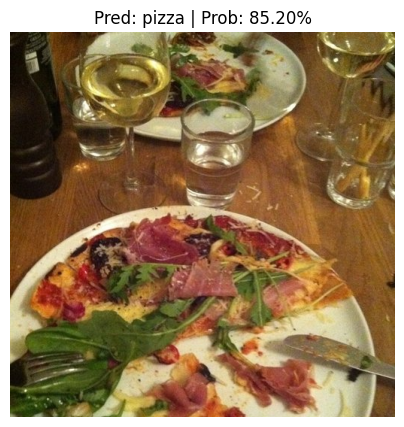

In [57]:
test_images = glob.glob(TEST_DIR+"/*/*.jpg")
random_img_3 = random.sample(test_images, k=3)

weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT
transform_efficientNet_B2 = weights.transforms()


for image_path in random_img_3:

    predict_img(model=best_model,
                image_path=image_path,
                class_names=['pizza', 'steak', 'sushi'],
                transform=transform_efficientNet_B2,
                device=device)

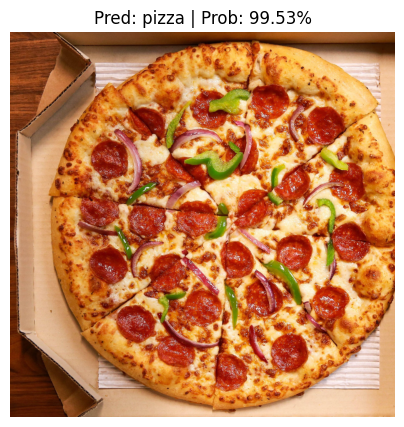

In [58]:
predict_img(model=best_model,
            image_path='/gdrive/MyDrive/data_food101/sample_pizza.jpg',
            class_names=['pizza', 'steak', 'sushi'],
            transform=transform_efficientNet_B2,
            device=device)